In [16]:
!pip install coqui-tts

In [19]:
!ls

best_model.pth	config_broken.json  config.json  sample_data


In [10]:
import os
# print(model_checkpoint_path, os.path.getsize(model_checkpoint_path))

In [9]:
from IPython.display import Audio


Uncomment the following lines to try your own examples:

In [6]:
import torch
from TTS.utils.synthesizer import Synthesizer
import soundfile as sf
import os


In [ ]:
!gdown --id 1Uro2gsqQ8SrcWHwx4BK8FCrBu-Oc0rPt --output best_model.pth
!wget -O config.json "https://drive.google.com/file/d/1gKd85Q7-yBO8A-f-fxWvazoWkDnuChfs"

/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1Uro2gsqQ8SrcWHwx4BK8FCrBu-Oc0rPt
From (redirected): https://drive.google.com/uc?id=1Uro2gsqQ8SrcWHwx4BK8FCrBu-Oc0rPt&confirm=t&uuid=0dad1f1f-36d6-41bd-ad64-5d13a5b08969
To: /content/best_model.pth
100% 998M/998M [00:12<00:00, 79.7MB/s]
--2025-09-04 10:32:16--  https://drive.google.com/file/d/1gKd85Q7-yBO8A-f-fxWvazoWkDnuChfs
Resolving drive.google.com (drive.google.com)... 108.177.11.102, 108.177.11.138, 108.177.11.139, ...
Connecting to drive.google.com (drive.google.com)|108.177.11.102|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://drive.google.com/file/d/1gKd85Q7-yBO8A-f-fxWvazoWkDnuChfs/ [following]
--2025-09-04 10:32:17--  https://drive.google.com/fi

In [23]:
!head -n 10 config.json
!wc -l config.json


{
    "output_path": "data_from_drive/content/tts_finetuning_output",
    "logger_uri": null,
    "run_name": "my_italian_finetuning",
    "project_name": null,
    "run_description": "",
    "print_step": 25,
    "plot_step": 100,
    "model_param_stats": false,
    "wandb_entity": null,
257 config.json


In [7]:
model_checkpoint_path = "best_model.pth"
config_path = "config.json"

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")

synthesizer = Synthesizer(
    tts_checkpoint=model_checkpoint_path,
    tts_config_path=config_path,
    use_cuda=torch.cuda.is_available(),

)

Using device: cpu


In [28]:
!pip install openai-whisper


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 803.2/803.2 kB 8.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for openai-whisper: filename=openai_whisper-20250625-py3-none-any.whl size=803979 sha256=8675480a3ecf5b99928294836c7dd1ca197b947282b07efa5ee21104ac46ff5b
  Stored in directory: /root/.cache/pip/wheels/61/d2/20/09ec9bef734d126cba375b15898010b6cc28578d8afdde5869
Successfully built openai-whisper


In [1]:
import os
import whisper


model = whisper.load_model("small")  # or "small", "large"

def transcribe_folder(audio_folder, language="it"):
    transcripts = {}
    for f in os.listdir(audio_folder):
        if f.endswith(".wav"):
            path = os.path.join(audio_folder, f)
            result = model.transcribe(path, language=language)
            transcripts[f] = result["text"].strip()
    return transcripts



100%|███████████████████████████████████████| 461M/461M [00:15<00:00, 31.4MiB/s]


In [20]:
import re
from num2words import num2words

In [21]:
def normalize_numbers_it(text: str) -> str:
    def replace_number(match):
        num = int(match.group(0))
        return num2words(num, lang='it')

    return re.sub(r'\d+', replace_number, text)


def transcribe_with_normalization(path, language="it"):
    result = model.transcribe(path, language=language)
    text = result["text"]
    text = normalize_numbers_it(text)
    return text

In [22]:
ref_folder = "ref_folder"

reference = {}
for fname in os.listdir(ref_folder):
    if fname.endswith(".wav"):
        path = os.path.join(ref_folder, fname)
        reference[fname] = transcribe_with_normalization(path, language="it")


reference





/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/

{'chunk_00900.wav': " Quindi è un avversario molto più difficile da ingabbiare, molto più scomodo da questo punto di vista. Forse ci vuole un'Italia ancora più lucida e capace di ragionare, un'Italia che si sappia difende...",
 'chunk_00700.wav': ' da pensare anche che la formazione ricalcherà inevitabilmente quella messa in campo nella prima partita, quindi con Buonucci.',
 'chunk_00600.wav': ' ormai superate anche perché lo spirito vero da considerare',
 'chunk_00500.wav': ' qualcosa del genere ha fatto Cristiano Ronaldo per andare a firmare.',
 'chunk_00300.wav': ' Antico cliente, antica conoscenza del calcio italiano, molti sono i precedenti...',
 'chunk_00200.wav': ' Buongiorno cari amici di quotidiano in classe, siamo qui per farvi gli auguri di Natale per riflettere insieme sul duemilatredici che sta arrivando. Si è chiusa un anno difficilissimo, il duemiladodici era',
 'chunk_00895.wav': ' ma nello stesso tempo con un modulo di gioco che sicuramente può dare fastidio ai tedesch

In [23]:
reference = {'chunk_00900.wav': " Quindi è un avversario molto più difficile da ingabbiare, molto più scomodo da questo punto di vista. Forse ci vuole un'Italia ancora più lucida e capace di ragionare, un'Italia che si sappia difende...",
 'chunk_00700.wav': ' da pensare anche che la formazione ricalcherà inevitabilmente quella messa in campo nella prima partita, quindi con Buonucci.',
 'chunk_00600.wav': ' ormai superate anche perché lo spirito vero da considerare',
 'chunk_00500.wav': ' qualcosa del genere ha fatto Cristiano Ronaldo per andare a firmare.',
 'chunk_00300.wav': ' Antico cliente, antica conoscenza del calcio italiano, molti sono i precedenti...',
 'chunk_00200.wav': ' Buongiorno cari amici di quotidiano in classe, siamo qui per farvi gli auguri di Natale per riflettere insieme sul duemilatredici che sta arrivando. Si è chiusa un anno difficilissimo, il duemiladodici era',
 'chunk_00895.wav': ' ma nello stesso tempo con un modulo di gioco che sicuramente può dare fastidio ai tedeschi. Qualcuno si chiede...',
 'chunk_00400.wav': ' Questo è la chiave, questi sono i temi tattici e strategici di una partita che si giocherà molto e soprattutto, però sul cuore.',
 'chunk_00100.wav': ' Da una parte, Germania e Francia, due nazionali che hanno fatto la storia e la tradizione.',
 'chunk_00799.wav': ' modestissima figura ma torniamo alla prospettiva italiana in vista della gara con Leire e come sapete sono sotto cartelino giallo sotto squalitica bufón bonucci chiellini'}

In [24]:
reference

{'chunk_00900.wav': " Quindi è un avversario molto più difficile da ingabbiare, molto più scomodo da questo punto di vista. Forse ci vuole un'Italia ancora più lucida e capace di ragionare, un'Italia che si sappia difende...",
 'chunk_00700.wav': ' da pensare anche che la formazione ricalcherà inevitabilmente quella messa in campo nella prima partita, quindi con Buonucci.',
 'chunk_00600.wav': ' ormai superate anche perché lo spirito vero da considerare',
 'chunk_00500.wav': ' qualcosa del genere ha fatto Cristiano Ronaldo per andare a firmare.',
 'chunk_00300.wav': ' Antico cliente, antica conoscenza del calcio italiano, molti sono i precedenti...',
 'chunk_00200.wav': ' Buongiorno cari amici di quotidiano in classe, siamo qui per farvi gli auguri di Natale per riflettere insieme sul duemilatredici che sta arrivando. Si è chiusa un anno difficilissimo, il duemiladodici era',
 'chunk_00895.wav': ' ma nello stesso tempo con un modulo di gioco che sicuramente può dare fastidio ai tedesch

In [31]:
for k, text in reference.items():
    out_path = os.path.join('ref_folder', k)
    display(Audio(filename=out_path))

In [26]:
for k, text in reference.items():
    wav = synthesizer.tts(text=text)
    out_path = os.path.join('synth_audio', k)
    sf.write(out_path, wav, synthesizer.output_sample_rate)
    display(Audio(out_path, rate=synthesizer.output_sample_rate))

In [34]:
out_dir = 'synth_audio'

In [42]:
hypotheses = {}
for fname in os.listdir(out_dir):
    if fname.endswith(".wav"):
        path = os.path.join(out_dir, fname)
        hypotheses[fname] = transcribe_with_normalization(path, language="it")
hypotheses

/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/

{'chunk_00900.wav': ' Quindi è un avversario molto più difficile di avviare, molto più scomodo da questo punto di lista. Forse ci vogliono in Italia ancora più lucidi e capaci di ragionare, ma in Italia che si sappia di fette.',
 'chunk_00700.wav': " La formazione di Cacrai in l'epidemia, che è l'esercanto nella prima partita, con Borucci.",
 'chunk_00600.wav': ' Ormai ssucate anche perché lo spito mi lo è considerare.',
 'chunk_00500.wav': ' Qualcosa di ovviamente ha fatto che stiano ronando per andare a firmare.',
 'chunk_00300.wav': ' Antico pliendere, antica conoscenza del calcio italiano, molte sono i precedenti.',
 'chunk_00200.wav': " Buongiorno a tutti i miei amici di Quotidiera in Classes, ero qui per farvi i diauridi a tal che ripretteressi e le surveci e le vesici che stanno arrivando. Il sito è ci useremo e non si, il disso rie, dov'è via, adio' di usi' la'",
 'chunk_00895.wav': ' Nel nostro tempo, con il modo di gioco che sicuramente coda e fastidio, il ruolo uno, chi è co

In [45]:
hypotheses

{'chunk_00900.wav': ' Quindi è un avversario molto più difficile di avviare, molto più scomodo da questo punto di lista. Forse ci vogliono in Italia ancora più lucidi e capaci di ragionare, ma in Italia che si sappia di fette.',
 'chunk_00700.wav': " La formazione di Cacrai in l'epidemia, che è l'esercanto nella prima partita, con Borucci.",
 'chunk_00600.wav': ' Ormai ssucate anche perché lo spito mi lo è considerare.',
 'chunk_00500.wav': ' Qualcosa di ovviamente ha fatto che stiano ronando per andare a firmare.',
 'chunk_00300.wav': ' Antico pliendere, antica conoscenza del calcio italiano, molte sono i precedenti.',
 'chunk_00200.wav': " Buongiorno a tutti i miei amici di Quotidiera in Classes, ero qui per farvi i diauridi a tal che ripretteressi e le surveci e le vesici che stanno arrivando. Il sito è ci useremo e non si, il disso rie, dov'è via, adio' di usi' la'",
 'chunk_00895.wav': ' Nel nostro tempo, con il modo di gioco che sicuramente coda e fastidio, il ruolo uno, chi è co

In [44]:
hypotheses = {'chunk_00900.wav': ' Quindi è un avversario molto più difficile di avviare, molto più scomodo da questo punto di lista. Forse ci vogliono in Italia ancora più lucidi e capaci di ragionare, ma in Italia che si sappia di fette.',
 'chunk_00700.wav': " La formazione di Cacrai in l'epidemia, che è l'esercanto nella prima partita, con Borucci.",
 'chunk_00600.wav': ' Ormai ssucate anche perché lo spito mi lo è considerare.',
 'chunk_00500.wav': ' Qualcosa di ovviamente ha fatto che stiano ronando per andare a firmare.',
 'chunk_00300.wav': ' Antico pliendere, antica conoscenza del calcio italiano, molte sono i precedenti.',
 'chunk_00200.wav': " Buongiorno a tutti i miei amici di Quotidiera in Classes, ero qui per farvi i diauridi a tal che ripretteressi e le surveci e le vesici che stanno arrivando. Il sito è ci useremo e non si, il disso rie, dov'è via, adio' di usi' la'",
 'chunk_00895.wav': ' Nel nostro tempo, con il modo di gioco che sicuramente coda e fastidio, il ruolo uno, chi è con quello si chiede.',
 'chunk_00400.wav': " Questo è l'Aciado, queste sono intennità di cestartici di la pratica che si agitarà l'Ortobre, e soprattutto la Sulkó.",
 'chunk_00100.wav': ' Alla parte Germania fanci e due nazionali che hanno fatto la scoria e la tradizione',
 'chunk_00799.wav': ' e la prospettiva italiana e il vista della gara con lei e come sapete sotto Cappello Giallo, subscribe, india buonossi, tiemini'}

In [46]:
from jiwer import wer

In [47]:
for file, ref_text in reference.items():
    hyp_text = hypotheses.get(file, "")
    score = wer(ref_text.lower(), hyp_text.lower())
    print(f"{file}: WER={score:.3f}")

chunk_00900.wav: WER=0.394
chunk_00700.wav: WER=0.722
chunk_00600.wav: WER=0.667
chunk_00500.wav: WER=0.455
chunk_00300.wav: WER=0.273
chunk_00200.wav: WER=1.094
chunk_00895.wav: WER=0.895
chunk_00400.wav: WER=0.696
chunk_00100.wav: WER=0.438
chunk_00799.wav: WER=0.640


In [ ]:
# compare with xtts

In [55]:
import torch
from TTS.api import TTS

device = "cuda" if torch.cuda.is_available() else "cpu"


print(TTS().list_models())


tts = TTS("tts_models/multilingual/multi-dataset/xtts_v2").to(device)

['tts_models/multilingual/multi-dataset/xtts_v2', 'tts_models/multilingual/multi-dataset/xtts_v1.1', 'tts_models/multilingual/multi-dataset/your_tts', 'tts_models/multilingual/multi-dataset/bark', 'tts_models/bg/cv/vits', 'tts_models/cs/cv/vits', 'tts_models/da/cv/vits', 'tts_models/et/cv/vits', 'tts_models/ga/cv/vits', 'tts_models/en/ek1/tacotron2', 'tts_models/en/ljspeech/tacotron2-DDC', 'tts_models/en/ljspeech/tacotron2-DDC_ph', 'tts_models/en/ljspeech/glow-tts', 'tts_models/en/ljspeech/speedy-speech', 'tts_models/en/ljspeech/tacotron2-DCA', 'tts_models/en/ljspeech/vits', 'tts_models/en/ljspeech/vits--neon', 'tts_models/en/ljspeech/fast_pitch', 'tts_models/en/ljspeech/overflow', 'tts_models/en/ljspeech/neural_hmm', 'tts_models/en/vctk/vits', 'tts_models/en/vctk/fast_pitch', 'tts_models/en/sam/tacotron-DDC', 'tts_models/en/blizzard2013/capacitron-t2-c50', 'tts_models/en/blizzard2013/capacitron-t2-c150_v2', 'tts_models/en/multi-dataset/tortoise-v2', 'tts_models/en/jenny/jenny', 'tts_m

100%|█████████▉| 1.86G/1.87G [00:41<00:00, 68.7MiB/s]
100%|██████████| 1.87G/1.87G [00:41<00:00, 44.9MiB/s]
4.37kiB [00:00, 32.7kiB/s]

361kiB [00:00, 2.33MiB/s]
100%|██████████| 32.0/32.0 [00:00<00:00, 205iB/s]
 26%|██▌       | 1.99M/7.75M [00:00<00:00, 19.9MiB/s]

In [57]:


for k, text in reference.items():
    wav = synthesizer.tts(text=text)
    out_path = os.path.join('xtts', k)
    # sf.write(out_path, wav, synthesizer.output_sample_rate)

    tts.tts_to_file(
      text=text.lower(),
      speaker_wav="chunk_00600.wav",
      language="it",
      file_path=out_path
    )
    display(Audio(out_path, rate=synthesizer.output_sample_rate))

/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/utils.py:213: UserWarning: In 2.9, this function's implementation will be changed to use torchaudio.load_with_torchcodec` under the hood. Some parameters like ``normalize``, ``format``, ``buffer_size``, and ``backend`` will be ignored. We recommend that you port your code to rely directly on TorchCodec's decoder instead: https://docs.pytorch.org/torchcodec/stable/generated/torchcodec.decoders.AudioDecoder.html#torchcodec.decoders.AudioDecoder.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/ffmpeg.py:88: UserWarning: torio.io._streaming_media_decoder.StreamingMediaDecoder has been deprecated. This deprecation is part of a large refactoring effort to transition TorchAudio into a maintenance phase. The decoding and encoding capabilities of PyTorch for both audio and video are being consolidated into TorchCodec. Please see https://github.com/pytorch/audio/issues/3902 for more information. It will be r

In [58]:
hypxtts = {}

out_dir = 'xtts'
for fname in os.listdir(out_dir):
    if fname.endswith(".wav"):
        path = os.path.join(out_dir, fname)
        hypxtts[fname] = transcribe_with_normalization(path, language="it")
hypxtts

/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")
/usr/local/lib/

{'chunk_00900.wav': " quindi è un avversario molto più difficile da ingabbiare, molto più scomodo da questo punto di vista. Il piccolo, forse ci vuole un'Italia ancora più lucida e capace di ragionare un'Italia che si sappia difende.",
 'chunk_00700.wav': ' da pensare anche che la formazione ricalcherà inevitabilmente quella messa in campo nella prima partita, quindi con buon ucci.',
 'chunk_00600.wav': ' ormai superate anche perché lo spirito vero da considerare.',
 'chunk_00500.wav': ' qualcosa del genere ha fatto Cristiano Ronaldo per andare a firmare, appunto.',
 'chunk_00300.wav': ' antico cliente e antica conoscenza del calcio italiano. Molti sono i precedenti.',
 'chunk_00200.wav': ' Buongiorno. Buongiorno, cari amici di quotidiano in classe, siamo qui per farvi gli auguri di Natale. Per a Thorin Fletcher insieme sul duemilatredici che sta arrivando. È chiusa un anno difficilissimo, il duemiladodici era.',
 'chunk_00895.wav': ' ma nello stesso tempo con un modulo di gioco che si

In [59]:
hypxtts = {'chunk_00900.wav': " quindi è un avversario molto più difficile da ingabbiare, molto più scomodo da questo punto di vista. Il piccolo, forse ci vuole un'Italia ancora più lucida e capace di ragionare un'Italia che si sappia difende.",
 'chunk_00700.wav': ' da pensare anche che la formazione ricalcherà inevitabilmente quella messa in campo nella prima partita, quindi con buon ucci.',
 'chunk_00600.wav': ' ormai superate anche perché lo spirito vero da considerare.',
 'chunk_00500.wav': ' qualcosa del genere ha fatto Cristiano Ronaldo per andare a firmare, appunto.',
 'chunk_00300.wav': ' antico cliente e antica conoscenza del calcio italiano. Molti sono i precedenti.',
 'chunk_00200.wav': ' Buongiorno. Buongiorno, cari amici di quotidiano in classe, siamo qui per farvi gli auguri di Natale. Per a Thorin Fletcher insieme sul duemilatredici che sta arrivando. È chiusa un anno difficilissimo, il duemiladodici era.',
 'chunk_00895.wav': ' ma nello stesso tempo con un modulo di gioco che sicuramente può dare fastidio ai tedeschi.',
 'chunk_00400.wav': ' Questo è la chiave. Questi sono i temi tattici e strategici di una partita che si giocherà molto e soprattutto però sul cuore.',
 'chunk_00100.wav': ' Da una parte, Germania e Francia, due nazionali che hanno fatto la storia e la tradizione.lu.',
 'chunk_00799.wav': ' Modestissima figura, ma torniamo alla prospettiva italiana in vista della gara con le ele. E come sapete sono sotto cartellino, giallo, sotto squalitica. Buffon, bonucci, chiellini.'}

In [60]:
for file, ref_text in reference.items():
    hyp_text = hypxtts.get(file, "")
    score = wer(ref_text.lower(), hyp_text.lower())
    print(f"{file}: WER={score:.3f}")

chunk_00900.wav: WER=0.121
chunk_00700.wav: WER=0.111
chunk_00600.wav: WER=0.111
chunk_00500.wav: WER=0.182
chunk_00300.wav: WER=0.364
chunk_00200.wav: WER=0.250
chunk_00895.wav: WER=0.158
chunk_00400.wav: WER=0.087
chunk_00100.wav: WER=0.062
chunk_00799.wav: WER=0.360


In [61]:
for file, ref_text in reference.items():
    hyp_text = hypotheses.get(file, "")
    score = wer(ref_text.lower(), hyp_text.lower())
    print(f"{file}: WER={score:.3f}")

chunk_00900.wav: WER=0.394
chunk_00700.wav: WER=0.722
chunk_00600.wav: WER=0.667
chunk_00500.wav: WER=0.455
chunk_00300.wav: WER=0.273
chunk_00200.wav: WER=1.094
chunk_00895.wav: WER=0.895
chunk_00400.wav: WER=0.696
chunk_00100.wav: WER=0.438
chunk_00799.wav: WER=0.640


In [51]:
%matplotlib inline


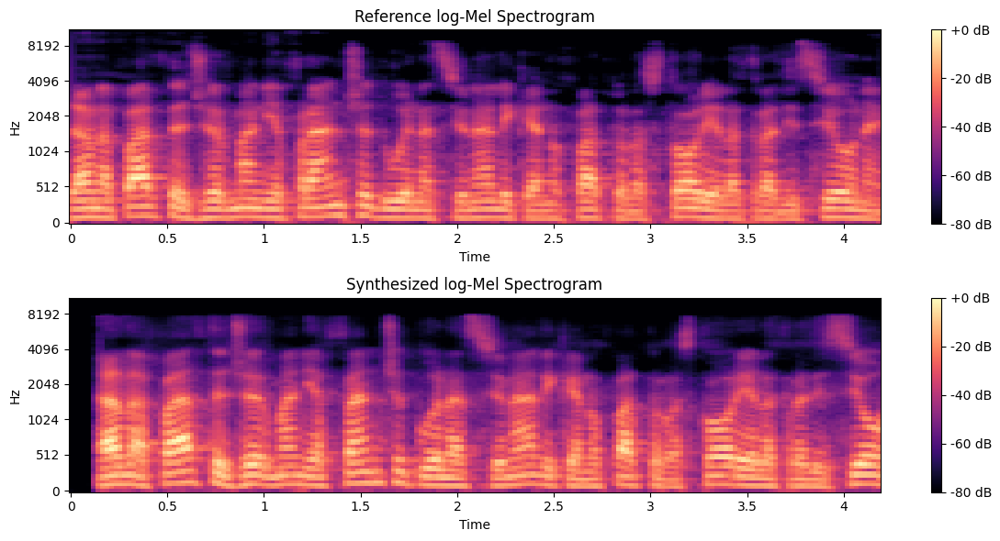

In [53]:
import librosa
import librosa.display
import matplotlib.pyplot as plt

ref_file = "ref_folder/chunk_00100.wav"
syn_file = "synth_audio/chunk_00100.wav"

# Load audio
ref, sr = librosa.load(ref_file, sr=22050)
syn, sr2 = librosa.load(syn_file, sr=sr)

n_mels = 80

# Compute mel spectrograms (use keyword args)
ref_mel = librosa.feature.melspectrogram(y=ref, sr=sr, n_mels=n_mels)
syn_mel = librosa.feature.melspectrogram(y=syn, sr=sr, n_mels=n_mels)

# Convert to log scale
ref_mel_db = librosa.power_to_db(ref_mel, ref=np.max)
syn_mel_db = librosa.power_to_db(syn_mel, ref=np.max)

# Match time lengths
min_frames = min(ref_mel_db.shape[1], syn_mel_db.shape[1])
ref_mel_db = ref_mel_db[:, :min_frames]
syn_mel_db = syn_mel_db[:, :min_frames]

# Plot
plt.figure(figsize=(12, 6))

plt.subplot(2, 1, 1)
librosa.display.specshow(ref_mel_db, sr=sr, x_axis='time', y_axis='mel')
plt.title("Reference log-Mel Spectrogram")
plt.colorbar(format="%+2.0f dB")

plt.subplot(2, 1, 2)
librosa.display.specshow(syn_mel_db, sr=sr, x_axis='time', y_axis='mel')
plt.title("Synthesized log-Mel Spectrogram")
plt.colorbar(format="%+2.0f dB")

plt.tight_layout()
plt.show()
